In [1]:
!pip install yfinance

In [2]:
import yfinance as yf
import pandas as pd

assets = ["AAPL", "MSFT", "GOOG"]  # Replace with your desired assets
pf_data = pd.DataFrame()

for a in assets:
    data = yf.download(a, start="2010-01-01")
    # Extract the 'Close' prices for the specific asset
    pf_data[a] = data[('Close', a)]

print(pf_data)

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed

                  AAPL        MSFT        GOOG
Date                                          
2010-01-04    6.447410   23.300682   15.554351
2010-01-05    6.458558   23.308214   15.485855
2010-01-06    6.355827   23.165167   15.095475
2010-01-07    6.344076   22.924257   14.744061
2010-01-08    6.386255   23.082352   14.940615
...                ...         ...         ...
2024-12-16  251.039993  451.589996  198.160004
2024-12-17  253.479996  454.459991  197.119995
2024-12-18  248.050003  437.390015  190.149994
2024-12-19  249.789993  437.029999  189.699997
2024-12-20  254.490005  436.600006  192.960007

[3768 rows x 3 columns]


<Axes: xlabel='Date'>

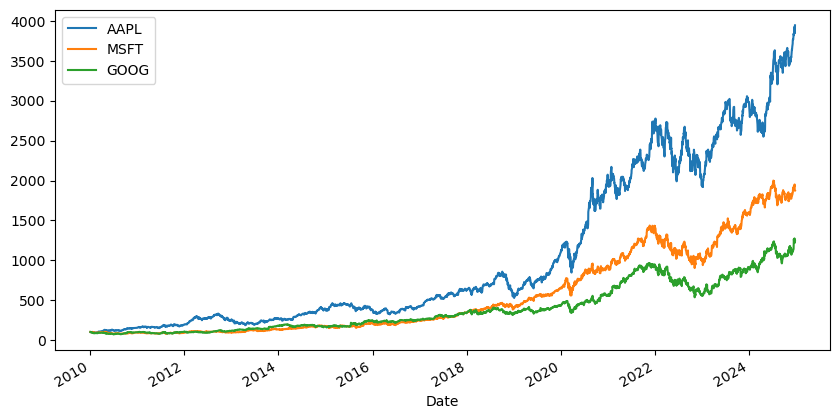

In [3]:
(pf_data / pf_data.iloc[0] * 100).plot(figsize=(10, 5))

In [4]:
import numpy as np
log_returns = np.log(pf_data / pf_data.shift(1))

In [5]:
log_returns.mean() * 250

AAPL    0.243933
MSFT    0.194487
GOOG    0.167119
dtype: float64

In [6]:
log_returns.cov() * 250

,AAPL,MSFT,GOOG
AAPL,0.077160,0.041760,0.041464
MSFT,0.041760,0.064952,0.044277
GOOG,0.041464,0.044277,0.073879


In [7]:
log_returns.corr()

,AAPL,MSFT,GOOG
AAPL,1.000000,0.589885,0.549183
MSFT,0.589885,1.000000,0.639177
GOOG,0.549183,0.639177,1.000000


In [8]:
num_assets = len(assets)
num_assets

3

In [9]:
arr = np.random.random(2)
arr

array([0.16788465, 0.71517938])

In [10]:
arr[0] + arr[1]

0.8830640326793643

In [11]:
weights = np.random.random(num_assets)
weights /= np.sum(weights)
weights

array([0.43956138, 0.0565845 , 0.50385412])

In [12]:
weights[0] + weights[1]

0.4961458777590332

In [13]:
np.sum(weights * log_returns.mean()) * 250

0.20243189111565776

In [14]:
np.dot(weights.T, np.dot(log_returns.cov() * 250, weights))

0.05684085485549599

In [15]:
np.sqrt(np.dot(weights.T,np.dot(log_returns.cov() * 250, weights)))

0.23841320193205742

In [16]:
pfolio_returns = []
pfolio_volatilities = []

for x in range (1000):
    weights = np.random.random(num_assets)
    weights /= np.sum(weights)
    pfolio_returns.append(np.sum(weights * log_returns.mean()) * 250)
    pfolio_volatilities.append(np.sqrt(np.dot(weights.T,np.dot(log_returns.cov() * 250, weights))))

pfolio_returns, pfolio_volatilities

([0.22177490202255393,
  0.20683150962429628,
  0.1979886732690107,
  0.2045413402257197,
  0.20985525951089914,
  0.2135831106345346,
  0.2050877590688734,
  0.2307716792620831,
  0.19799423989913909,
  0.18502998515615204,
  0.2117490961019807,
  0.1929631350060656,
  0.1838995738011976,
  0.21289680615968393,
  0.22073464119711178,
  0.21499279825636428,
  0.19324939021847176,
  0.20446107198926766,
  0.2055450842427934,
  0.19818416090425867,
  0.21014854162126684,
  0.1947653927655516,
  0.20957675382534974,
  0.18606505237776938,
  0.19241527671954148,
  0.19663734841461344,
  0.21741824315030364,
  0.20310804685147443,
  0.199862828914924,
  0.20474662704524355,
  0.21286285669045757,
  0.21671956501621387,
  0.20392516052673076,
  0.1954383410263777,
  0.19634146515697468,
  0.18931722703796314,
  0.19302572579684332,
  0.19172883728152115,
  0.1982427844799381,
  0.2131633674516913,
  0.18665512122660183,
  0.2239520156464234,
  0.21797981301608862,
  0.17510019403566454,
  0.

In [17]:
pfolio_returns = []
pfolio_volatilities = []

for x in range (1000):
    weights = np.random.random(num_assets)
    weights /= np.sum(weights)
    pfolio_returns.append(np.sum(weights * log_returns.mean()) * 250)
    pfolio_volatilities.append(np.sqrt(np.dot(weights.T,np.dot(log_returns.cov() * 250, weights))))
    
pfolio_returns = np.array(pfolio_returns)
pfolio_volatilities = np.array(pfolio_volatilities)

pfolio_returns, pfolio_volatilities

(array([0.21192364, 0.19884393, 0.21313875, 0.2132676 , 0.21022132,
        0.20598562, 0.19729934, 0.20373775, 0.21499727, 0.19875188,
        0.19534026, 0.20165672, 0.19076305, 0.20898777, 0.20351729,
        0.20497639, 0.18641902, 0.19162352, 0.20894019, 0.20411959,
        0.19542997, 0.20955631, 0.2037898 , 0.19942233, 0.20582506,
        0.20195864, 0.19861348, 0.1900851 , 0.19863321, 0.196107  ,
        0.18924026, 0.17811131, 0.19308261, 0.18589288, 0.19783956,
        0.2146307 , 0.20433836, 0.19774822, 0.20501881, 0.22763206,
        0.22015762, 0.18712265, 0.2186372 , 0.16807484, 0.2061833 ,
        0.19062684, 0.19406995, 0.20644656, 0.19153876, 0.19379673,
        0.19499422, 0.20491942, 0.19338872, 0.19218496, 0.20753025,
        0.19215179, 0.18641183, 0.17254107, 0.19638076, 0.19203707,
        0.22027695, 0.1813495 , 0.21377711, 0.1837162 , 0.20242756,
        0.19691827, 0.21574406, 0.19932166, 0.18686244, 0.18701505,
        0.18450085, 0.20466945, 0.19088097, 0.20

In [18]:
portfolios = pd.DataFrame({'Return': pfolio_returns, 'Volatility': pfolio_volatilities})

In [19]:
portfolios.sample(20)

,Return,Volatility
985,0.171259,0.257362
210,0.199541,0.231122
715,0.199125,0.235232
575,0.195088,0.234412
384,0.222358,0.239312
204,0.226344,0.243853
481,0.202271,0.233311
159,0.188640,0.235744
595,0.220005,0.243995
723,0.193911,0.229647


Text(0, 0.5, 'Expected Return')

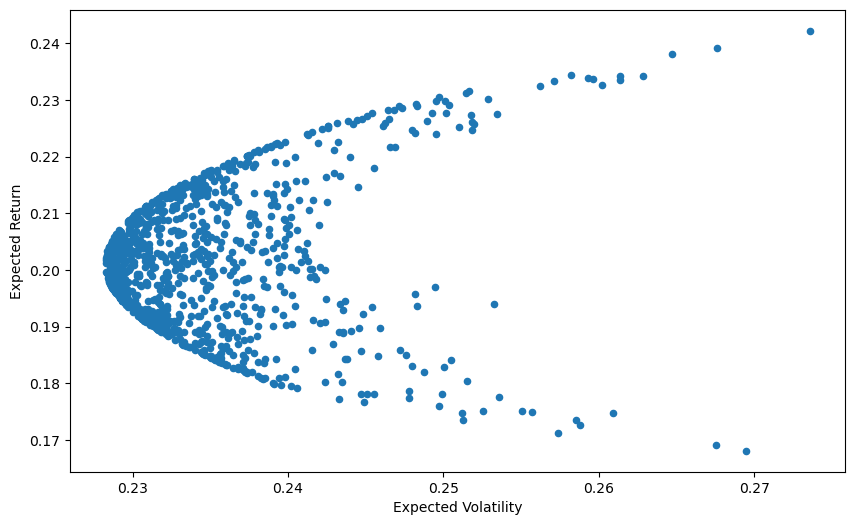

In [20]:
import matplotlib.pyplot as plt
portfolios.plot(x='Volatility', y='Return', kind='scatter', figsize=(10, 6));
plt.xlabel('Expected Volatility')
plt.ylabel('Expected Return')

In [21]:
import yfinance as yf
import numpy as np
import pandas as pd
import plotly.express as px

# Step 1: Download Stock Data
assets = ["AAPL", "MSFT", "GOOG"]
data = yf.download(assets, start="2015-01-01", end="2024-12-01")

# Extract Close prices
close_prices = data.loc[:, ('Close', slice(None))]
close_prices.columns = close_prices.columns.droplevel(0)  # Flatten MultiIndex

# Step 2: Calculate Daily Returns
returns = close_prices.pct_change().dropna()

# Step 3: Portfolio Simulation
num_portfolios = 5000
np.random.seed(42)

portfolio_returns = []
portfolio_volatilities = []
portfolio_weights = []

for _ in range(num_portfolios):
    weights = np.random.random(len(assets))
    weights /= np.sum(weights)
    portfolio_weights.append(weights)

    # Calculate Portfolio Return
    ret = np.sum(weights * returns.mean()) * 252  # Annualized return
    portfolio_returns.append(ret)

    # Calculate Portfolio Volatility
    vol = np.sqrt(np.dot(weights.T, np.dot(returns.cov() * 252, weights)))  # Annualized volatility
    portfolio_volatilities.append(vol)

# Create a DataFrame for Portfolio Metrics
portfolios = pd.DataFrame({
    'Return': portfolio_returns,
    'Volatility': portfolio_volatilities,
})

# Add weights as individual columns for hover data
for i, asset in enumerate(assets):
    portfolios[asset + ' Weight'] = [w[i] for w in portfolio_weights]

# Step 4: Plot Efficient Frontier with Plotly Express
fig = px.scatter(
    portfolios,
    x='Volatility',
    y='Return',
    title='Efficient Frontier',
    labels={'Volatility': 'Expected Volatility', 'Return': 'Expected Return'},
    hover_data={asset + ' Weight': True for asset in assets}  # Show weights on hover
)

# Show the interactive plot
fig.show()

[*********************100%***********************]  3 of 3 completed


In [22]:
# Step 1: Calculate Sharpe Ratio
portfolios['Sharpe Ratio'] = portfolios['Return'] / portfolios['Volatility']

# Step 2: Identify the Best Portfolio (highest Sharpe Ratio)
best_portfolio_idx = portfolios['Sharpe Ratio'].idxmax()
portfolios['Best'] = portfolios.index == best_portfolio_idx

# Step 3: Plot with Highlighted Dot
fig = px.scatter(
    portfolios,
    x='Volatility',
    y='Return',
    color='Best',  # Highlight the best portfolio
    color_discrete_map={True: 'red', False: 'blue'},  # Best in red, others in blue
    hover_data={
        'Sharpe Ratio': ':.2f',
        'AAPL Weight': ':.2f',
        'MSFT Weight': ':.2f',
        'GOOG Weight': ':.2f'
    },
    title='Efficient Frontier with Highlighted Best Portfolio',
    labels={'Volatility': 'Expected Volatility', 'Return': 'Expected Return'}
)

# Show the plot
fig.show()

In [23]:
#Correlated and not diversified assests
import yfinance as yf
import numpy as np
import pandas as pd
import plotly.express as px

# Step 1: Use the top 30 stocks
top_30_stocks = ['NVDA', 'UNH', 'MSFT', 'AAPL', 'TMO', 'AMZN', 'TSLA', 'MA', 'HD', 'ADBE',
                 'NFLX', 'ACN', 'V', 'GOOG', 'ABT', 'MRK', 'PEP', 'JPM', 'JNJ', 'PFE',
                 'PG', 'KO', 'CSCO', 'CVX', 'WMT', 'XOM', 'META', 'CMCSA', 'INTC', 'DIS']

# Step 2: Download data for these stocks
data = yf.download(top_30_stocks, start="2015-01-01", end="2024-12-01")['Close']

# Step 3: Calculate daily returns
returns = data.pct_change().dropna()

# Step 4: Portfolio Simulation
num_portfolios = 5000
np.random.seed(42)

portfolio_returns = []
portfolio_volatilities = []
portfolio_weights = []

for _ in range(num_portfolios):
    weights = np.random.random(len(top_30_stocks))
    weights /= np.sum(weights)
    portfolio_weights.append(weights)

    # Calculate Portfolio Return
    ret = np.sum(weights * returns.mean()) * 252  # Annualized return
    portfolio_returns.append(ret)

    # Calculate Portfolio Volatility
    vol = np.sqrt(np.dot(weights.T, np.dot(returns.cov() * 252, weights)))  # Annualized volatility
    portfolio_volatilities.append(vol)

# Create a DataFrame for Portfolio Metrics
portfolios = pd.DataFrame({
    'Return': portfolio_returns,
    'Volatility': portfolio_volatilities,
})

# Add weights as individual columns for hover data
for i, stock in enumerate(top_30_stocks):
    portfolios[stock + ' Weight'] = [w[i] for w in portfolio_weights]

# Calculate Sharpe Ratio
portfolios['Sharpe Ratio'] = portfolios['Return'] / portfolios['Volatility']

# Identify the best portfolio (highest Sharpe Ratio)
best_portfolio_idx = portfolios['Sharpe Ratio'].idxmax()
portfolios['Best'] = portfolios.index == best_portfolio_idx

# Step 5: Plot Efficient Frontier
fig = px.scatter(
    portfolios,
    x='Volatility',
    y='Return',
    color='Best',  # Highlight the best portfolio
    color_discrete_map={True: 'red', False: 'blue'},  # Red for best, blue for others
    hover_data={
        'Sharpe Ratio': ':.2f',
        **{stock + ' Weight': ':.2f' for stock in top_30_stocks}  # Show weights on hover
    },
    title='Efficient Frontier with Top 30 Stocks',
    labels={'Volatility': 'Expected Volatility', 'Return': 'Expected Return'}
)

# Show the plot
fig.show()

# Step 6: Display the Best Portfolio Details
print("Best Portfolio:")
print(portfolios.loc[best_portfolio_idx])

[*********************100%***********************]  30 of 30 completed


Best Portfolio:
Return          0.252632
Volatility      0.196923
NVDA Weight     0.024253
UNH Weight      0.008907
MSFT Weight     0.034071
AAPL Weight     0.007401
TMO Weight      0.061385
AMZN Weight     0.012066
TSLA Weight     0.016613
MA Weight       0.026726
HD Weight       0.025183
ADBE Weight     0.052228
NFLX Weight     0.029991
ACN Weight      0.011224
V Weight        0.017562
GOOG Weight     0.033461
ABT Weight      0.009691
MRK Weight        0.0402
PEP Weight      0.037183
JPM Weight      0.046973
JNJ Weight       0.06163
PFE Weight      0.059957
PG Weight        0.06218
KO Weight       0.016084
CSCO Weight     0.008647
CVX Weight      0.019867
WMT Weight      0.058828
XOM Weight      0.063887
META Weight     0.056478
CMCSA Weight    0.007231
INTC Weight     0.062269
DIS Weight      0.027825
Sharpe Ratio    1.282894
Best                True
Name: 240, dtype: object


In [24]:
# List of assets (stocks + worldwide indices)
assets = [
    "AAPL", "MSFT", "GOOG",  # Stocks
    "^GSPC", "^DJI", "^IXIC", "^FTSE", "^GDAXI", "^FCHI", "^N225", "^HSI", "000001.SS", "^BSESN"  # Indices
]

# Initialize an empty DataFrame
pf_data = pd.DataFrame()

# Fetch data for each asset
for a in assets:
    data = yf.download(a, start="2010-01-01")
    # Extract the 'Close' prices and add to the DataFrame
    pf_data[a] = data['Close']

# Normalize prices for comparison
normalized_pf_data = (pf_data / pf_data.iloc[0]) * 100

# Plot normalized prices
px.line(normalized_pf_data,title="Normalized Prices for Stocks and Indices (Base = 100)")


[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed


| Index Name              | Ticker      | Description                                                                 |
|-------------------------|-------------|-----------------------------------------------------------------------------|
| S&P 500                | ^GSPC       | Tracks the performance of the 500 largest publicly traded companies in the US. |
| Dow Jones Industrial Average | ^DJI  | Tracks 30 large, publicly owned US companies from various industries.       |
| NASDAQ Composite       | ^IXIC       | Tracks over 3,000 stocks listed on the NASDAQ stock exchange, tech-heavy.   |
| FTSE 100               | ^FTSE       | Tracks the 100 largest companies listed on the London Stock Exchange (UK).  |
| DAX                    | ^GDAXI      | Tracks the 40 largest and most liquid companies on the Frankfurt Stock Exchange (Germany). |
| CAC 40                 | ^FCHI       | Tracks the 40 largest companies on the Paris Stock Exchange (France).       |
| Nikkei 225             | ^N225       | Tracks 225 large companies listed on the Tokyo Stock Exchange (Japan).      |
| Hang Seng Index        | ^HSI        | Tracks the largest companies listed on the Hong Kong Stock Exchange.        |
| Shanghai Composite     | 000001.SS   | Tracks all A-shares and B-shares listed on the Shanghai Stock Exchange (China). |
| BSE Sensex             | ^BSESN      | Tracks 30 financially strong companies listed on the Bombay Stock Exchange (India). |
| MSCI World Index       | URTH (ETF)  | Tracks large and mid-cap companies across 23 developed markets worldwide.   |
| Euro Stoxx 50          | ^STOXX50E   | Tracks 50 blue-chip companies from 11 Eurozone countries.                   |
| Russell 2000           | ^RUT        | Tracks 2,000 small-cap companies in the US.                                 |
| VIX (Volatility Index) | ^VIX        | Measures market expectations of near-term volatility from S&P 500 options.  |
| ASX 200                | ^AXJO       | Tracks the 200 largest companies on the Australian Stock Exchange.          |
| KOSPI                  | ^KS11       | Tracks companies listed on the Korea Stock Exchange (South Korea).          |
